# TTT4185 Machine learning for Speech technology

## Voluntary computer assigment 1: Speech analysis

This assignment assumes that the student has knowledge about short-time spectral estimation, linear prediction modeling and cepstral analysis. You should also know the concept of fundamental frequencies and formants.

Useful commands include `matplotlib.pyplot.plot`.

### Problem 1

In this problem we will look at a speech signal and do simple spectral analysis on the signal.

(a) Download the speech file `stry.wav` from Blackboard and load the file using `scipy.io.wavefile.read`. The speech represents the latter half of the English word "tapestry". The phonetic transcription is /s/ /t/ /r/ /iy/.
- Plot the signal.
- What is characteristic about the sounds /s/, /t/, /r/ and /iy/?
- Take a 40 millisecond subset of the vowel /iy/ and plot it.
- Find the fundamental frequency $F_0$ of the vowel.

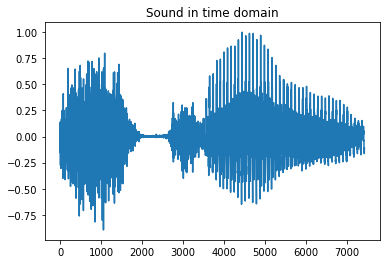

In [23]:
import scipy.io.wavfile
import matplotlib.pyplot as plt
from scipy import signal

import numpy as np
import scipy

Fs, data = scipy.io.wavfile.read('stry.wav')
data = data /np.max(data)
plt.title("Sound in time domain")
plt.plot(data)

The different sounds have different formants, that means they have each a distinct set of peaks in the fourier transform. The sets of these peaks are different for each sound.

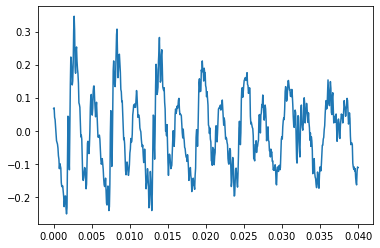

In [24]:
last_forty = int(Fs*0.04)
last_sound = data[-last_forty:]
time_scale = np.linspace(0, len(last_sound)/Fs,len(last_sound))
plt.plot(time_scale, last_sound)
plt.show()

The fundamental frequency is given as $$ F_0 = \frac{7}{0.0331} = 211Hz$$
Since there are 7 peaks spanned over a 0.0331s time period.

(b) Spectral analysis
- Estimate the spectrum of the vowel using an FFT of length 1024. Plot the log-spectrum as a function of frequency
- Multiply the signal by a Hamming window and repeat the last operation.
- Explain the difference between the two spectra.
- Estimate the fundamental frequency $F_0$ using the spectrum, and compare the result to what you got in 1a)
- Roughly estimate the two first formant frequencies.

Useful Python functions: `numpy.fft.fft`, `numpy.abs`, `scipy.signal.hamming`.

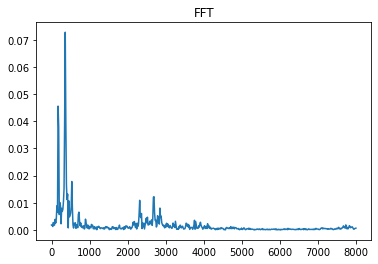

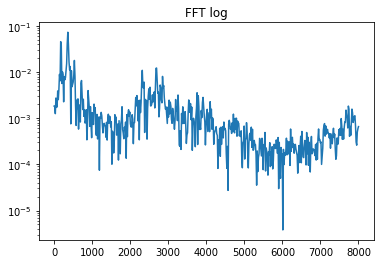

In [25]:
# Spectrum
fft_len = 1024
spectrum = np.fft.fft(last_sound,n=fft_len)
freqz = np.linspace(0, Fs/2.0,len(spectrum)//2)
spectrum_len = len(spectrum)//2
plt.title("FFT")
plt.plot(freqz,2.0/fft_len * np.abs(spectrum[:spectrum_len]))
plt.show()
plt.title("FFT log")
plt.yscale("log")
plt.plot(freqz, 2.0/fft_len *(np.abs(spectrum[:spectrum_len])))
plt.show()

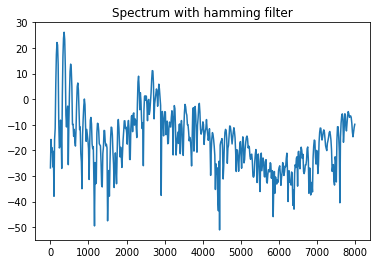

In [26]:
# hamming
spctrum_length = fft_len//2
ham = signal.windows.hamming(len(last_sound))
hammed_sound = ham*last_sound
hammed_spectrum = np.fft.fft(hammed_sound, n=fft_len)
end = len(hammed_spectrum)//2
hammed_spectrum = hammed_spectrum[:end]
plt.title("Spectrum with hamming filter")
plt.plot(freqz, 20*np.log10(np.abs(hammed_spectrum)))


TODO: Find the fundamnetal frequency and the first two formants

(c) AR modeling
- Compute the coefficients of an AR model (linear prediction coefficients) with order 4, 8, 16 and 50, based on the vowel.
- Estimate the spectrum for each of the model orders. Plot the log-spectrum as a function of frequency.
- Compare your results with the spectrum from 1b). Which model order yields the "best" spectral envelope? What happens if the model order is too high or too low?
- Why is it impossible to estimate the fundamental frequency based on the LP model?

Useful Python functions: `pysptk.sptk.lpc`, `scipy.signal.freqz`.

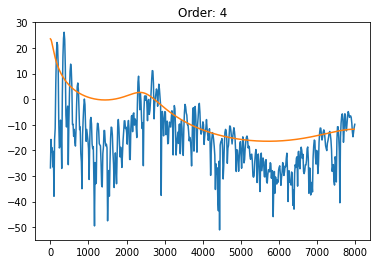

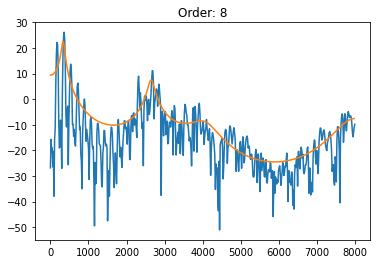

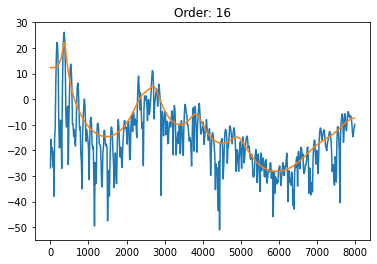

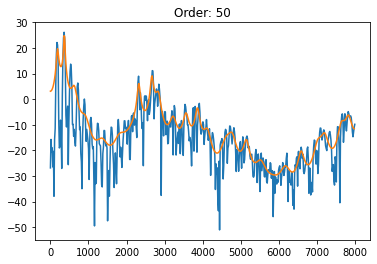

In [27]:
import pysptk

for i in [4,8,16,50]:
    linear_pred = pysptk.sptk.lpc(hammed_sound, order=i)
    w, H = signal.freqz(b=linear_pred[0], a=(np.concatenate(([1],linear_pred[1:]))), fs=Fs)
    plt.plot(freqz, 20*np.log10(np.abs(hammed_spectrum)))
    plt.plot(w,20*np.log10(np.abs(H)))
    plt.title("Order: " +str(i))
    plt.show()

(d) Use `scipy.signal.spectrogram` to create a spectrogram of the entire speech signal. Try to generate both wide- and narrow-band spectrograms by adjutinf the window lengths and overlaps. Which characteristic traits of the speech sounds /s/, /t/, /r/ and /iy/ can you see from the spectrogram?

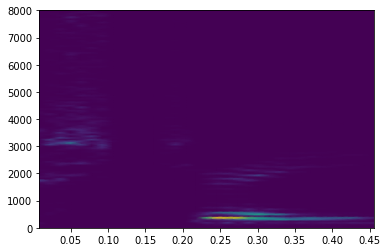

In [28]:
f, t, Sxx = signal.spectrogram(data,fs=Fs)
plt.pcolormesh(t, f, Sxx, shading='gouraud')
plt.show()

### Problem 2
In this problem we look at the cepstrum and deconvolution

(a) Compute and plot the real cepstrum of the vowel from problem 1a).

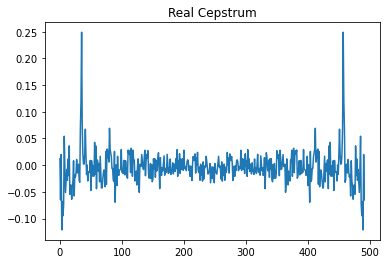

In [59]:

ceps = np.fft.ifft(np.log(np.abs(hammed_spectrum)))
plt.plot(range(len(ceps[10:-10])), ceps[10:-10].real)
plt.title("Real Cepstrum")
plt.show()


(b) Use the cepstrum to compute the fundamental frequency $F_0$. Compare your results with those obtained in problem 1).

If the sample number at first peak of the cepstrum is $P_0$ The fundamental frequency is  $\frac{Fs}{P_0} = F_0$ 
This gives us $\frac{16kHz}{47} = 340$  with $P_0 = 47$


(c) In this subproblem you will use the cepstrum to estimate the spectral envelope
- Use liftering to extract the part of the ceptrum that represents the spectral envelope.
- Plot the spectral envelope as a function of frequency, and compare the result with the results from problem 1).

Hint 1: Remember that the cepstrum of a real signal is symmetric, so the liftered signal mus be symmetric as well.

Hint 2: The FFT of a real, symmtric signal is real, but due to round-off errors small imaginary noise may occur. Use `np.real` to get to the real part of the liftered log-spectrum.

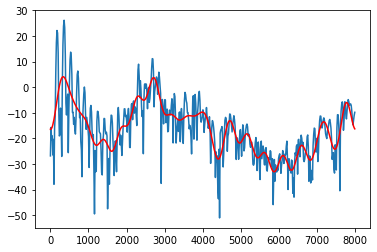

In [60]:
# Setting everything to zero except the first 20 vlaues/coeficcients
import copy
ceps_chopped = np.zeros(ceps.shape[0])
ceps_chopped = copy.deepcopy(ceps)
ceps_chopped[20:-20] = 0

N = 512
fft_ceps_chopped = np.abs(np.exp(np.fft.fft(ceps_chopped, n=N)))
freqz_ceps = np.linspace(0, Fs/2, N)
plt.plot(freqz, 20*np.log10((hammed_spectrum)))
plt.plot(freqz_ceps, 20*np.log10(fft_ceps_chopped[:N]),'r')